In [1]:
! git clone https://github.com/Mb-NextTime/early-med.git
! cd early-med && rm -r pycaret && rm -r TabEBM
! cd early-med && git clone https://github.com/Mb-NextTime/pycaret.git && git clone https://github.com/Mb-NextTime/TabEBM.git
! cd early-med && ./setup.sh
! cp early-med/src/utils.py .

Cloning into 'early-med'...
remote: Enumerating objects: 24, done.
remote: Counting objects: 100% (24/24), done.
remote: Compressing objects: 100% (15/15), done.
remote: Total 24 (delta 8), reused 24 (delta 8), pack-reused 0 (from 0)
Receiving objects: 100% (24/24), 6.40 MiB | 9.97 MiB/s, done.
Resolving deltas: 100% (8/8), done.
Cloning into 'pycaret'...
remote: Enumerating objects: 30225, done.
remote: Counting objects: 100% (310/310), done.
remote: Compressing objects: 100% (109/109), done.
remote: Total 30225 (delta 248), reused 206 (delta 201), pack-reused 29915 (from 3)
Receiving objects: 100% (30225/30225), 261.14 MiB | 10.89 MiB/s, done.
Resolving deltas: 100% (22247/22247), done.
Updating files: 100% (319/319), done.
Cloning into 'TabEBM'...
remote: Enumerating objects: 123, done.
remote: Counting objects: 100% (123/123), done.
remote: Compressing objects: 100% (85/85), done.
remote: Total 123 (delta 66), reused 82 (delta 35), pack-reused 0 (from 0)
Receiving objects: 100% (12

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import missingno as msno
import openml
from category_encoders import LeaveOneOutEncoder, CatBoostEncoder
import matplotlib.pyplot as plt

import pycaret
from pycaret.classification import ClassificationExperiment
from pycaret.datasets import get_data

from sklearn.metrics import balanced_accuracy_score
from sklearn.model_selection import train_test_split

from ydata_profiling import ProfileReport

from utils import *

In [2]:
full_data = openml.datasets.get_dataset(1494).get_data()[0]
full_data.shape

(1055, 42)

In [8]:
data, _ = train_test_split(full_data, train_size=200, random_state=0)

In [ ]:
profile = ProfileReport(data, title="Pandas Profiling Report")
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [9]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 200 entries, 25 to 684
Data columns (total 42 columns):
 #   Column  Non-Null Count  Dtype   
---  ------  --------------  -----   
 0   V1      200 non-null    float64 
 1   V2      200 non-null    float64 
 2   V3      200 non-null    uint8   
 3   V4      200 non-null    uint8   
 4   V5      200 non-null    uint8   
 5   V6      200 non-null    uint8   
 6   V7      200 non-null    uint8   
 7   V8      200 non-null    float64 
 8   V9      200 non-null    uint8   
 9   V10     200 non-null    uint8   
 10  V11     200 non-null    uint8   
 11  V12     200 non-null    float64 
 12  V13     200 non-null    float64 
 13  V14     200 non-null    float64 
 14  V15     200 non-null    float64 
 15  V16     200 non-null    uint8   
 16  V17     200 non-null    float64 
 17  V18     200 non-null    float64 
 18  V19     200 non-null    uint8   
 19  V20     200 non-null    uint8   
 20  V21     200 non-null    uint8   
 21  V22     200 non-null

In [10]:
n_classes = data['Class'].unique().size

---
### CatBoostEncoder

In [11]:
exp = ClassificationExperiment()
exp.setup(
    data,
    target='Class',
    session_id=42,
    preprocess=True,
    imputation_type='simple',
    normalize=True,
    normalize_method='zscore',
    encoding_method=CatBoostEncoder(),
    max_encoding_ohe=2,
    n_jobs=1
)

,Description,Value
0,Session id,42
1,Target,Class
2,Target type,Binary
3,Target mapping,"1: 0, 2: 1"
4,Original data shape,"(200, 42)"
5,Transformed data shape,"(200, 42)"
6,Transformed train set shape,"(140, 42)"
7,Transformed test set shape,"(60, 42)"
8,Numeric features,41
9,Preprocess,True


In [12]:
best = exp.compare_models(exclude=['lda', 'dummy', 'nb', 'qda'], cross_validation=True)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
et,Extra Trees Classifier,0.8357,0.9256,0.8357,0.8524,0.8307,0.6489,0.6696,0.0640
lr,Logistic Regression,0.8286,0.8957,0.8286,0.8454,0.8263,0.6463,0.6613,0.0210
catboost,CatBoost Classifier,0.8286,0.9083,0.8286,0.8541,0.8194,0.6283,0.6593,1.0900
rf,Random Forest Classifier,0.8214,0.8930,0.8214,0.8523,0.8137,0.6215,0.6546,0.0840
ada,Ada Boost Classifier,0.8214,0.8768,0.8214,0.8328,0.8181,0.6256,0.6393,0.0670
lightgbm,Light Gradient Boosting Machine,0.8071,0.8746,0.8071,0.8312,0.7994,0.5889,0.6159,0.0290
xgboost,Extreme Gradient Boosting,0.8000,0.8729,0.8000,0.8189,0.7944,0.5780,0.5988,0.0530
knn,K Neighbors Classifier,0.7929,0.8745,0.7929,0.8131,0.7937,0.5851,0.5961,0.0220
dt,Decision Tree Classifier,0.7929,0.7774,0.7929,0.8060,0.7862,0.5589,0.5767,0.0190
svm,SVM - Linear Kernel,0.7929,0.8571,0.7929,0.8081,0.7865,0.5629,0.5798,0.0200


In [13]:
best = exp.create_model('et')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9286,1.0000,0.9286,0.9405,0.9297,0.8511,0.8607
1,0.8571,0.9778,0.8571,0.8831,0.8464,0.6585,0.7006
2,0.7143,0.7778,0.7143,0.7143,0.7143,0.3778,0.3778
3,0.9286,1.0000,0.9286,0.9388,0.9289,0.8571,0.8660
4,0.7857,0.9167,0.7857,0.8442,0.7669,0.5333,0.6030
5,0.7857,1.0000,0.7857,0.8442,0.7669,0.5333,0.6030
6,0.8571,0.9583,0.8571,0.8571,0.8571,0.7083,0.7083
7,0.7143,0.8958,0.7143,0.7143,0.7143,0.4167,0.4167
8,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000


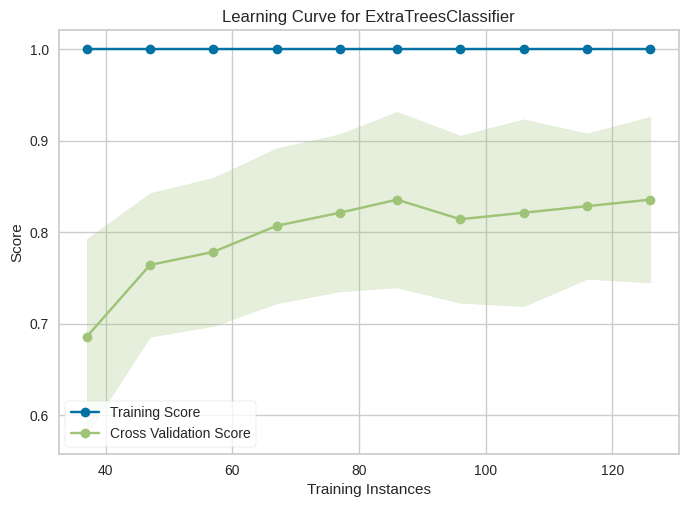

In [14]:
exp.plot_model(best, plot='learning')

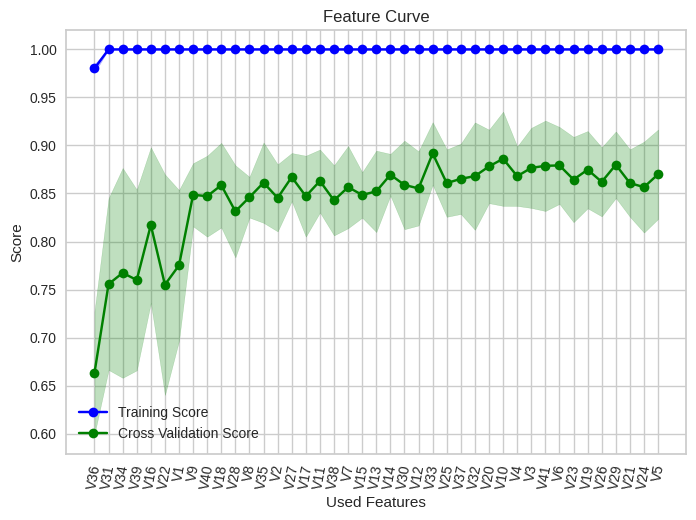

In [15]:
fc = FeatureCurve(best, exp.X_train_transformed, exp.y_train_transformed)
fc.fit(exp.X_train_transformed, exp.y_train_transformed)

In [26]:
fc.features_order_[:25]

Index(['V36', 'V31', 'V34', 'V39', 'V16', 'V22', 'V1', 'V9', 'V40', 'V18',
       'V28', 'V8', 'V35', 'V2', 'V27', 'V17', 'V11', 'V38', 'V7', 'V15',
       'V13', 'V14', 'V30', 'V12', 'V33'],
      dtype='object')

CPU times: user 28.9 s, sys: 46.6 ms, total: 29 s
Wall time: 29 s


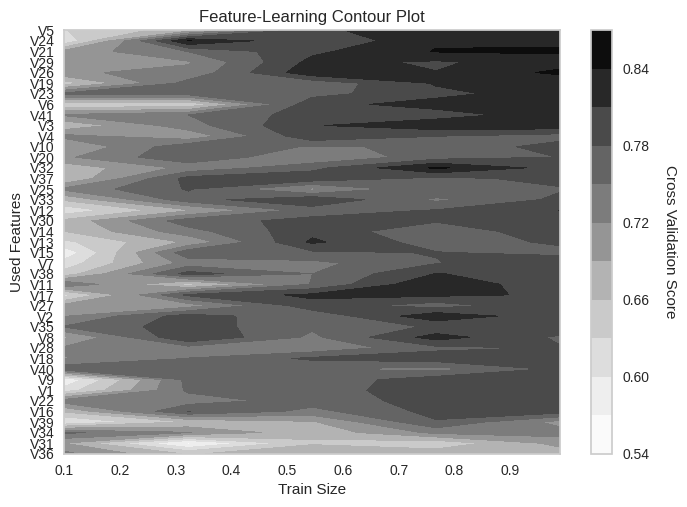

In [16]:
%%time
flc = FeatureLearningCurve(best, exp.X_train_transformed, exp.y_train_transformed, cv=3,
                           features_order=fc.features_order_, scoring=balanced_accuracy_score
)
flc.fit(exp.X_train_transformed, exp.y_train_transformed, exp.X_test_transformed, exp.y_test_transformed)

---
### TabEBM with CatBoostEncoder

In [9]:
from tabebm.TabEBM import TabEBM

In [10]:
tabebm = TabEBM(plotting=False)
augmented_data = tabebm.generate(exp.X_train_transformed.values, exp.y_train_transformed.values, num_samples=500//n_classes)

In [11]:
X_syn = np.concatenate(list(augmented_data.values()))
y_syn = np.concatenate([np.full(len(augmented_data[f"class_{i}"]), i) for i in range(len(augmented_data.keys()))])
X_train_augmented = np.concatenate([exp.X_train_transformed, X_syn])
y_train_augmented = np.concatenate([exp.y_train_transformed, y_syn])

In [12]:
best.fit(exp.X_train_transformed, exp.y_train_transformed)
balanced_accuracy_score(best.predict(exp.X_test_transformed), exp.y_test_transformed)

0.7102272727272727

In [13]:
best.fit(X_train_augmented, y_train_augmented)
balanced_accuracy_score(best.predict(exp.X_test_transformed), exp.y_test_transformed)

0.8125854993160054

---
### Full data experiement

In [31]:
exp_full = ClassificationExperiment()
exp_full.setup(
    full_data,
    target='Class',
    session_id=42,
    preprocess=True,
    imputation_type='simple',
    normalize=True,
    normalize_method='zscore',
    encoding_method=CatBoostEncoder(),
    max_encoding_ohe=2,
    n_jobs=1
)

,Description,Value
0,Session id,42
1,Target,Class
2,Target type,Binary
3,Target mapping,"1: 0, 2: 1"
4,Original data shape,"(1055, 42)"
5,Transformed data shape,"(1055, 42)"
6,Transformed train set shape,"(738, 42)"
7,Transformed test set shape,"(317, 42)"
8,Numeric features,41
9,Preprocess,True


In [32]:
best_full = exp_full.compare_models(exclude=['lda', 'dummy', 'nb', 'qda'], cross_validation=True)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
catboost,CatBoost Classifier,0.8754,0.9320,0.8754,0.8784,0.8743,0.7179,0.7229,2.6600
et,Extra Trees Classifier,0.8753,0.9245,0.8753,0.8758,0.8738,0.7154,0.7187,0.1060
lr,Logistic Regression,0.8740,0.9368,0.8740,0.8749,0.8729,0.7144,0.7173,0.0650
rf,Random Forest Classifier,0.8659,0.9269,0.8659,0.8677,0.8639,0.6932,0.6985,0.1430
ridge,Ridge Classifier,0.8658,0.9211,0.8658,0.8655,0.8651,0.6969,0.6980,0.0420
gbc,Gradient Boosting Classifier,0.8618,0.9254,0.8618,0.8639,0.8597,0.6840,0.6897,0.3070
ada,Ada Boost Classifier,0.8591,0.9133,0.8591,0.8650,0.8584,0.6847,0.6914,0.1050
lightgbm,Light Gradient Boosting Machine,0.8564,0.9201,0.8564,0.8583,0.8558,0.6774,0.6802,0.0950
knn,K Neighbors Classifier,0.8549,0.8995,0.8549,0.8602,0.8556,0.6799,0.6835,0.0270
xgboost,Extreme Gradient Boosting,0.8537,0.9138,0.8537,0.8553,0.8525,0.6687,0.6724,0.1080


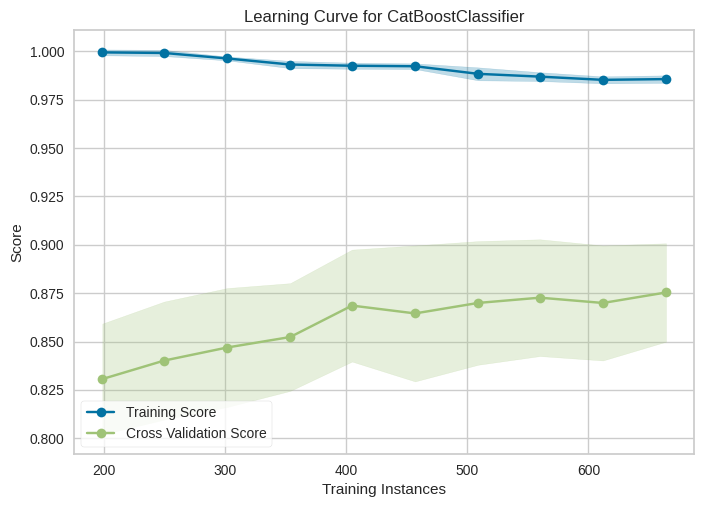

In [ ]:
exp_full.plot_model(best_full, plot='learning')

In [27]:
exp_full = ClassificationExperiment()
exp_full.setup(
    full_data[[*fc.features_order_[:25], 'Class']],
    target='Class',
    session_id=42,
    preprocess=True,
    imputation_type='simple',
    normalize=True,
    normalize_method='zscore',
    encoding_method=CatBoostEncoder(),
    max_encoding_ohe=2,
    n_jobs=1
)

,Description,Value
0,Session id,42
1,Target,Class
2,Target type,Binary
3,Target mapping,"1: 0, 2: 1"
4,Original data shape,"(1055, 26)"
5,Transformed data shape,"(1055, 26)"
6,Transformed train set shape,"(738, 26)"
7,Transformed test set shape,"(317, 26)"
8,Numeric features,25
9,Preprocess,True


In [28]:
best_full = exp_full.compare_models(exclude=['lda', 'dummy', 'nb', 'qda'], cross_validation=True)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
et,Extra Trees Classifier,0.8686,0.9188,0.8686,0.8689,0.8669,0.6999,0.7033,0.0920
catboost,CatBoost Classifier,0.8672,0.9286,0.8672,0.8694,0.8661,0.6995,0.7036,2.1850
gbc,Gradient Boosting Classifier,0.8631,0.9231,0.8631,0.8653,0.8615,0.6888,0.6937,0.2430
lr,Logistic Regression,0.8631,0.9200,0.8631,0.8639,0.8626,0.6922,0.6938,0.0430
rf,Random Forest Classifier,0.8618,0.9242,0.8618,0.8628,0.8599,0.6839,0.6885,0.1430
lightgbm,Light Gradient Boosting Machine,0.8605,0.9174,0.8605,0.8619,0.8597,0.6855,0.6883,0.0730
xgboost,Extreme Gradient Boosting,0.8496,0.9157,0.8496,0.8505,0.8482,0.6586,0.6621,0.0820
ridge,Ridge Classifier,0.8469,0.9135,0.8469,0.8452,0.8446,0.6487,0.6512,0.0370
svm,SVM - Linear Kernel,0.8402,0.8974,0.8402,0.8429,0.8395,0.6412,0.6448,0.0200
ada,Ada Boost Classifier,0.8401,0.9065,0.8401,0.8475,0.8402,0.6466,0.6527,0.0960
